In [247]:
from __future__ import annotations
from itertools import chain
from collections import defaultdict
from tqdm import tqdm
import os
from build import get_names
import numpy as np
import networkx as nx
import pandas as pd

import matplotlib as mpl
from matplotlib import pyplot as plt

import re
import networkx as nx
import networkx.algorithms.community as nx_comm
import nltk
from nltk import word_tokenize
from nltk.corpus import stopwords
from wordcloud import WordCloud

datapath = "../data"
localdatapath = "../local_data"

mpl.rcParams["font.family"] = "serif"
mpl.rcParams["figure.dpi"]  = 300

In [248]:
df = pd.read_csv(os.path.join(localdatapath, "book.csv"), header=0, index_col=0)
df["names"] = df.apply(lambda r: eval(r["names"]), axis=1)
df['selftext'] = df['text']
df = df.drop(['text'], axis = 1)
df.iloc[3]

book                                                        0
title                                                DAENERYS
names       [Daenerys Targaryen, Jorah Mormont, Viserys Ta...
selftext    DAENERYS\n\n\n\n\n\nHer brother held the gown ...
Name: 3, dtype: object

In [251]:
df_reddit = pd.read_csv(os.path.join(localdatapath, "asoiaf_data_cleaned.csv"), header=0, index_col=0)
df_reddit["names"] = df_reddit.apply(lambda r: eval(r["names"]), axis=1)
df_reddit = df_reddit[0:30000]

In [252]:
url = r"http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+"
num = r"\d"
punct = r"['""!(?.,:;*&_)#\-=\\·\[“”]"
stop_ord = list(stopwords.words("english")) 
stop_ord.extend(['would' , 'could', 'one', 'ser','twoiaf,', 'said','ned','…','“i','“the',' *',' -', 'like','–', '&gt;','*','|','--','•','jon','dany','bran'])
stop_ord = set(stop_ord)
stops = set(stopwords.words("english"))

def tokenize_sub(row):
    """ 
    Takes in a row of the GME submissions in Pandas dataframe and splits the selftext into tokens that are lower-cased
    and filtered for numbers, stop words, punctuations and URL's. We do not perform stemming and lemmatization as
    the full words are easier to understand in analysis than just using stems.
    """
    sub = row["selftext"]
    tokens = list()
    for w in sub.split():
        w = w.strip().lower()
        if re.search(num, w) or re.search(punct, w) or re.search(url, w) or w in stop_ord:
            continue
        w = re.sub(r"[^a-z]", "", w) 
        tokens.append(w)
    return tokens

df_reddit["tokens"] = df_reddit.apply(tokenize_sub, axis=1)
df["tokens"] = df.apply(tokenize_sub, axis=1)

In [253]:
namedict  = get_names("../data")
L = [name for name in namedict.values()]
nameset  = [name.lower() for name in list(chain(*L))]
nameset  = set(nameset)

In [254]:
DATAFRAME = df_reddit #"""""" df for books

In [255]:
docs = {k: list() for k in list(namedict)}
for names, tokens in zip(DATAFRAME["names"], DATAFRAME["tokens"]):
    if names:
        
        for i in range(len(names)):
            docs[names[i]] += tokens

In [ ]:
chosen = list(namedict.keys())
N = len(chosen)
doc_tfs = dict()
word_docs = defaultdict(lambda: set())
for stock in chosen:
    doc = docs[stock]
    M = len(doc)
    tfs = dict()
    for w in tqdm(set(doc)):
        tfs[w] = doc.count(w) / M
        word_docs[w].add(stock)
    print(
        f"Top 5 TF-terms for {stock.upper()}: \t" + ", ".join(
            list(reversed(sorted(tfs, key=tfs.get)))[:5]
        )
    )
    doc_tfs[stock] = tfs
doc_freqs = {w: len(d) for w, d in word_docs.items()}
doc_idfs = {
    stock: {w: np.log(N/(doc_freqs[w]+1)) for w in set(docs[stock])} 
        for stock in chosen
    }

  0%|                                                                                | 8/29289 [00:00<06:12, 78.51it/s]

Top 5 TF-terms for EDDARD 'NED' STARK: 	think, even, know, also, stark


  0%|                                                                                | 7/30150 [00:00<08:08, 61.67it/s]

Top 5 TF-terms for ROBERT BARATHEON: 	robert, even, think, know, king


  0%|                                                                                | 9/28328 [00:00<06:04, 77.80it/s]

Top 5 TF-terms for JAIME LANNISTER: 	jaime, cersei, tyrion, think, even


  0%|                                                                                | 7/31810 [00:00<08:24, 63.06it/s]

Top 5 TF-terms for CATELYN STARK: 	even, think, arya, know, also


 41%|██████████████████████████████▉                                             | 12966/31810 [03:21<04:29, 69.80it/s]

In [178]:
doc_tf_idf = {
    stock: {w: doc_tfs[stock][w] * doc_idfs[stock][w] for w in set(docs[stock])} 
        for stock in chosen
    }

for stock in chosen:
    tf_idf = doc_tf_idf[stock]
    print(f"Top 10 terms for {stock.upper()}")
    print(
        f"\tUsing TF:\t" + ", ".join(
            list(reversed(sorted(doc_tfs[stock], key=doc_tfs[stock].get)))[:10]
        )
    )
    print(
        f"\tUsing TF-IDF:\t" + ", ".join(
            list(reversed(sorted(tf_idf, key=tf_idf.get)))[:10]
        )
    )

Top 10 terms for EDDARD 'NED' STARK
	Using TF:	lord, man, men, back, even, never, told, made, tyrion, see
	Using TF-IDF:	asha, reek, davos, brienne, meera, bronn, luwin, osha, ramsay, ygritte
Top 10 terms for ROBERT BARATHEON
	Using TF:	lord, man, men, back, never, even, made, tyrion, king, told
	Using TF-IDF:	asha, davos, belwas, brienne, hizdahr, bronn, hotah, daario, kraznys, aeron
Top 10 terms for JAIME LANNISTER
	Using TF:	lord, tyrion, man, jaime, back, never, men, made, even, king
	Using TF-IDF:	brienne, bronn, tyrion, griff, margaery, kevan, creighton, illyrio, merrett, septa
Top 10 terms for CATELYN STARK
	Using TF:	lord, man, back, catelyn, men, never, made, told, even, see
	Using TF-IDF:	brienne, hizdahr, gerris, reznak, varamyr, edmure, haggon, bronn, waif, quentyn
Top 10 terms for CERSEI LANNISTER
	Using TF:	lord, tyrion, man, back, never, jaime, made, even, men, king
	Using TF-IDF:	griff, bronn, brienne, alayne, davos, tyrion, hotah, margaery, arianne, kevan
Top 10 terms 

In [179]:
#fig = plt.figure(figsize=(50, 50))
#axes = [] 
#for i in range(32): axes.append(fig.add_subplot(16, 2, i+1))
#    
#for name, ax in zip(chosen, axes):
#    wordcloud = WordCloud(
#        max_font_size=30,
#        scale = 2,
#        background_color="white",
#        colormap = "Dark2",
#    ).generate_from_frequencies(doc_tf_idf[name])
#    ax.imshow(wordcloud, interpolation="bilinear")
#    ax.axis("off")
    #ax.set_title(f"Words used by George R.R. Martin in describing {stock.upper()}", fontsize=10)
#plt.tight_layout()
#plt.show()

<ipython-input-189-dcc192cbb959>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(5, 5))


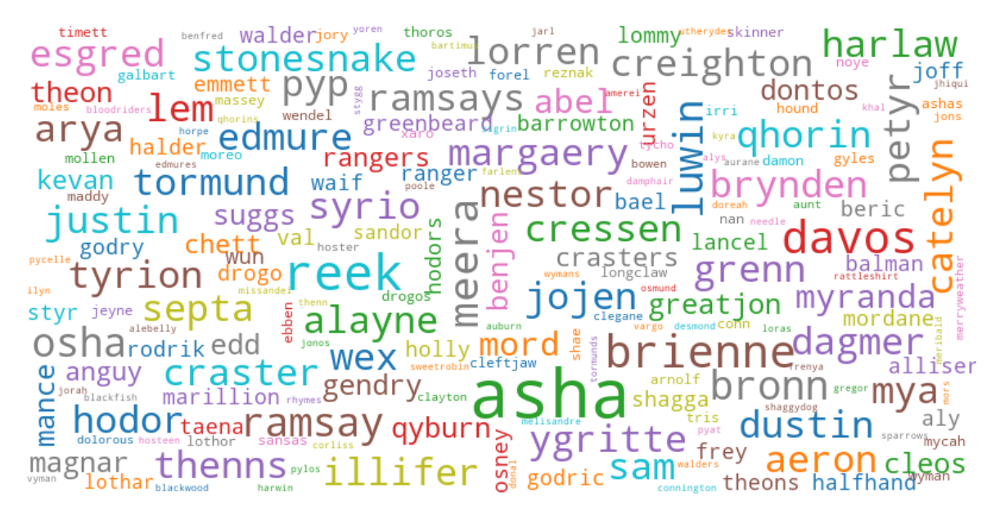

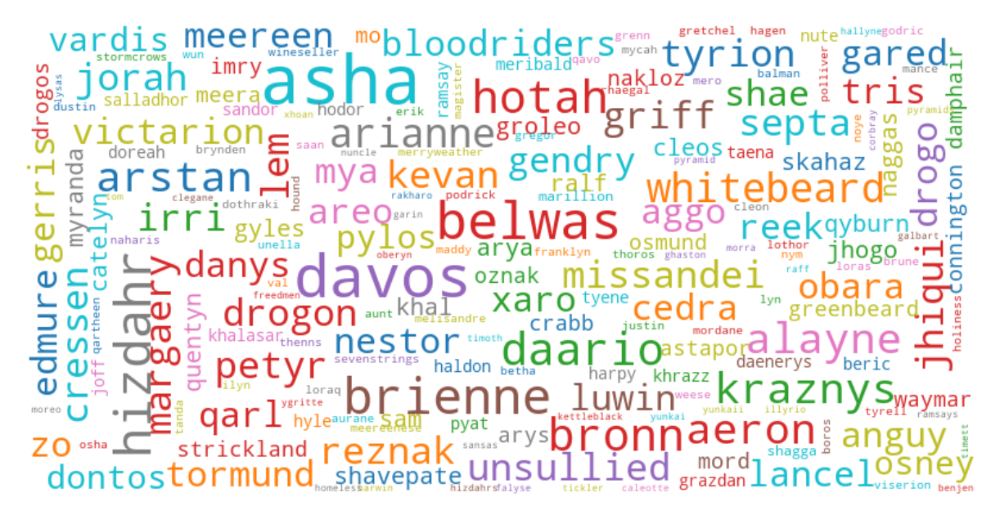

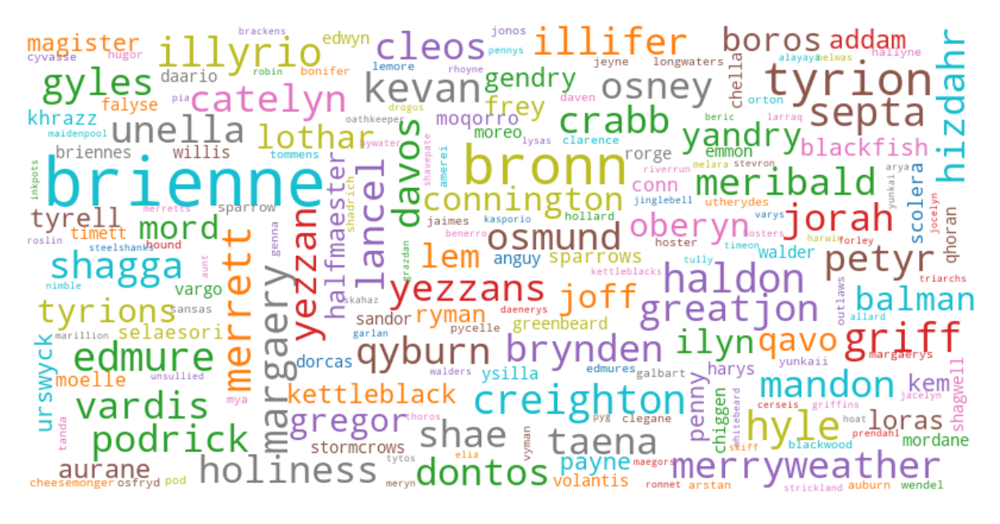

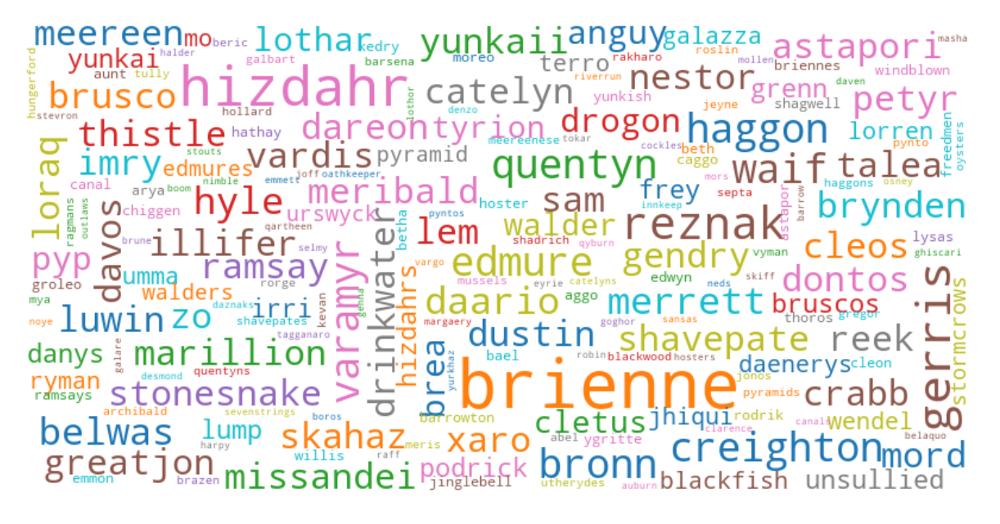

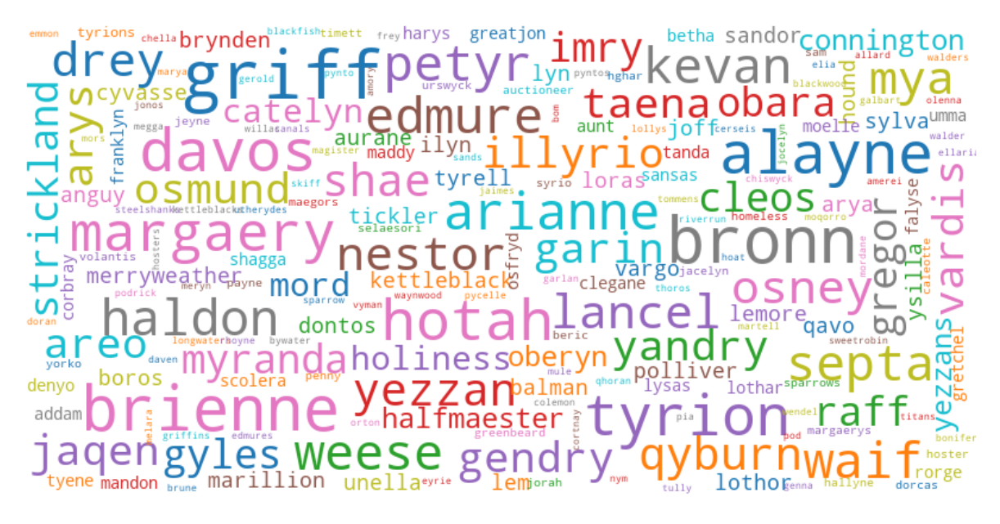

...

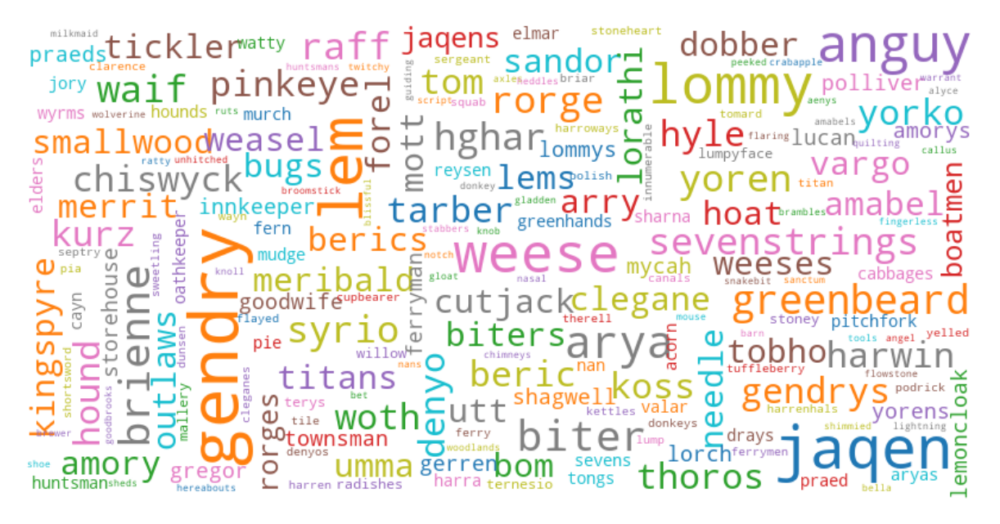

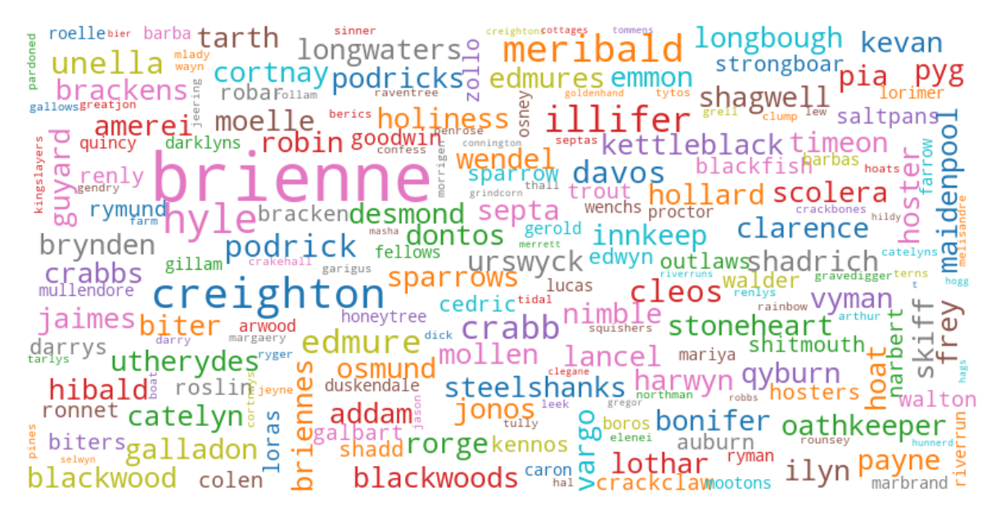

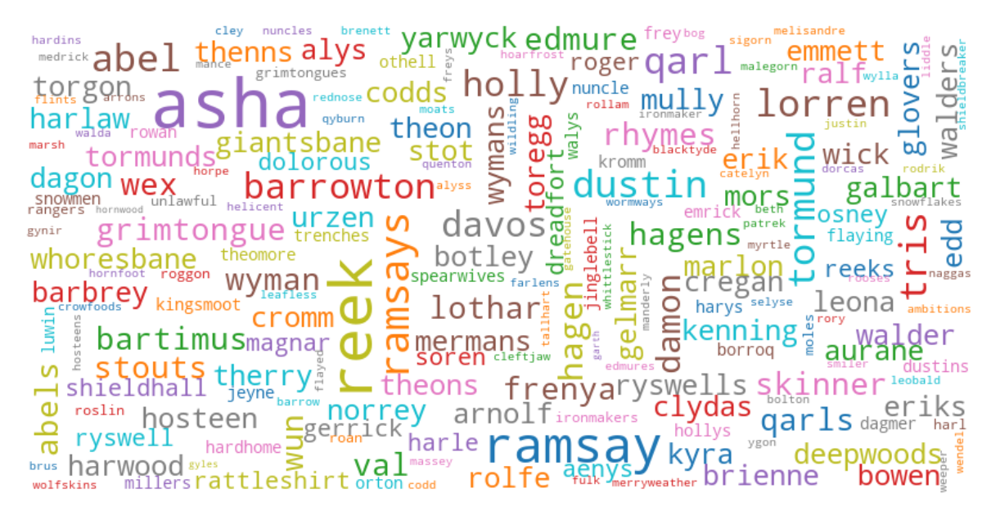

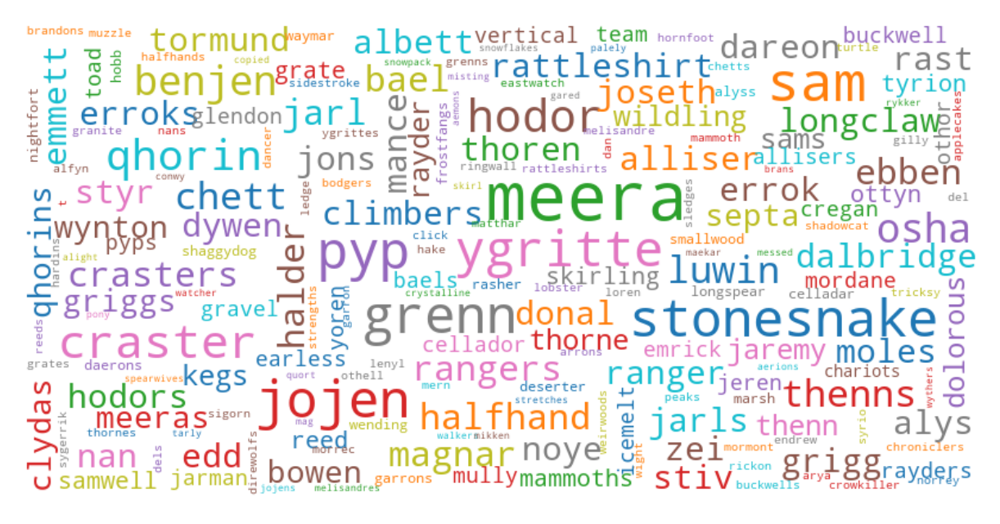

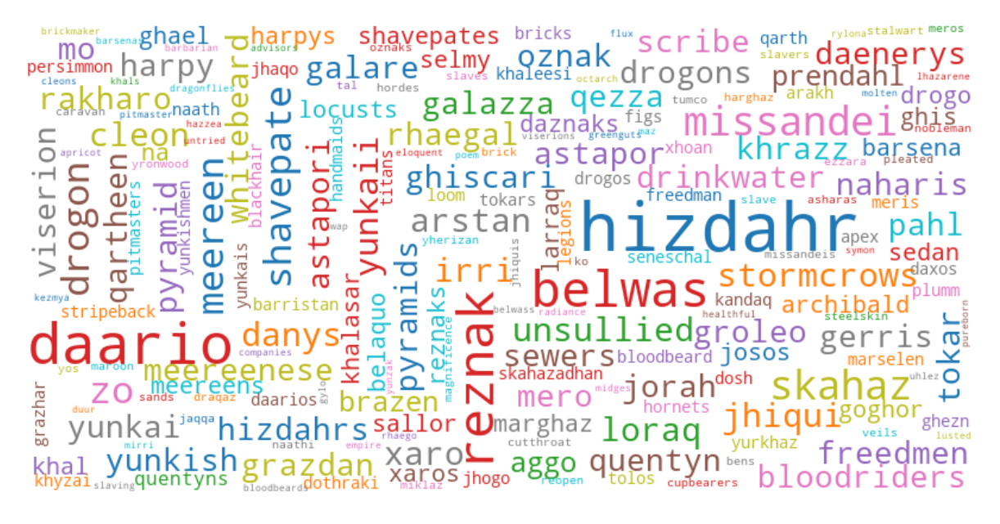

In [189]:
book = True
for name in chosen:
    wordcloud = WordCloud(
        max_font_size=28.5,
        scale = 2,
        background_color="white",
        colormap = "tab10",
    ).generate_from_frequencies(doc_tf_idf[name])
    fig = plt.figure(figsize=(5, 5))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    #plt.show()
    if book:
        plt.savefig("../data/" + f'{name}_wordcloud_book.png')
    else:
        plt.savefig("../data/" + f'{name}_wordcloud.png')
    

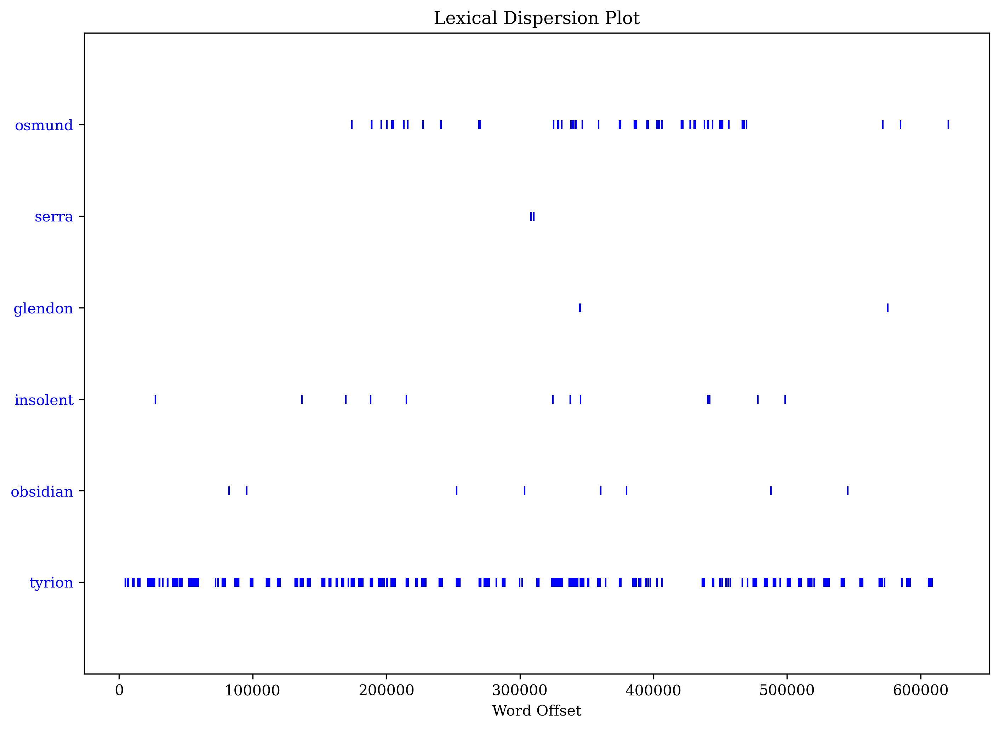

In [246]:
from nltk.draw.dispersion import dispersion_plot

L = [token for token in df['tokens']]
tokens  = [name.lower() for name in list(chain(*L))]
text = Text(tokens)
plt.figure(figsize=(11, 8))
ygritte=['spearwife','northerner','heralded','hoarse','weasel','powerful' ,'ygritte'] #Ygritte
viserys = ['strongs','yronwoods','regents','scolera','wineseller','artos', 'viserys'] #Viserys
varys = ['osmund','reznak','spiral', 'serra', 'battlefield' , 'fierceness' , 'varys']
tywin = ['fertile', 'yronwoods', 'quent', 'quentyn', 'plains', 'cletus', 'tywin']
tyrion = ['osmund','serra','glendon','insolent', 'obsidian' ,'tyrion']

target = tyrion
dispersion_plot(text, target, ignore_case=True, title='Lexical Dispersion Plot')
